<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">0. Intro</font><br>
- Where do you wanna go to TR'A'VEL?<br>
- Do you 'B'EAM yourself up on adventure?<br>
- Or outdoor A'C'TIVITY?<br>
- Then, 'D'RINK a beer?<br>
- 'E'lse, how about this?<br>
- There's something 'F'ANTASTIC over here!<br>
- F<br>
- UFO!<br>
</div>

In [1]:
!pip install IPython from IPython.display import Image

ERROR: Could not find a version that satisfies the requirement from (from versions: none)
ERROR: No matching distribution found for from


In [2]:
from IPython.display import Image

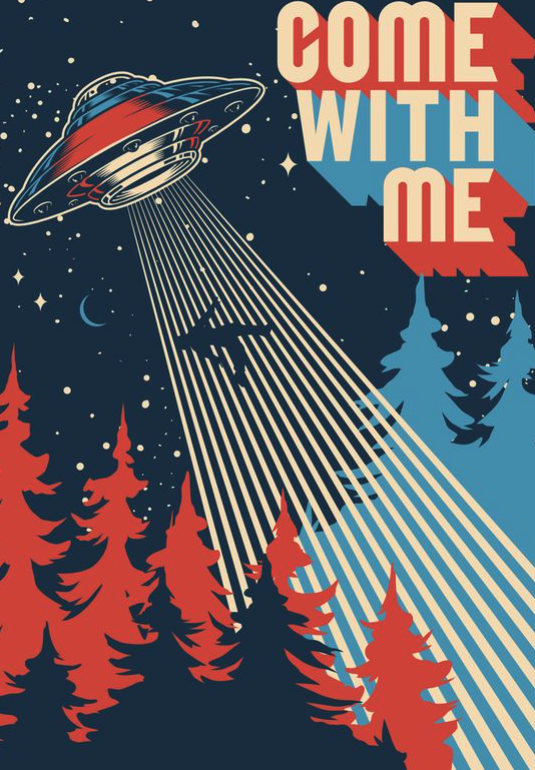

In [9]:
Image("/Users/bella/Desktop/come with me.png")

<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">1. Come With Me!</font><br>
- 주제: UFO 미국관광 투어를 위한 UFO 출몰지역 및 패턴데이터 분석<br>
- 4조: 진성은, 문채성, 안혁준, 정세윤, 최경화<br>
- 2022. 08. 26. Fri<br>
</div>

<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">2. 분석동기 및 목표</font><br>
- 미니프로젝트인 만큼 일반 대중들의 관심을 끌 만한 재미있는 주제 선택<br>
- UFO 목격 데이터가 있는 사이트를 찾은 후 웹 크롤링<br>
- 무려 1400년도부터 2022년도까지의 데이터가 있었고, 그중 2000년~2022년까지의 데이터 활용<br>
- ‘UFO 미국관광 투어를 위한 UFO 출몰지역 및 패턴데이터 분석’을 목표로 결정<br>
</div>

<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">3. 데이터 수집</font><br>
- National UFO Reporting Center 웹사이트의 Data Bank-Index by EVENT DATE 부분<br>
- https://nuforc.org/<br>
- 수집방법: 크롬 확장도구 'Instant Data Scraper'로 웹 크롤링<br>
- 수집 구간: 2000년 1월 ~ 2022년 6월<br>
- 최종 로우데이터 수 119,625개 중 미국(USA) 데이터 85,506개<br>
- 11개의 컬럼 중 필요없는 부분 삭제 후 총 7개의 컬럼을 활용하기로 함<br>
- 목격일시/목격도시/미국주코드/국가/UFO 모양/목격상황 요약/출몰듀레이션(초 단위)<br>
</div>

<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">4. 전처리</font><br>   
- 전체 데이터의 컬럼명 변경<br>
- Null 값 처리<br>
- ‘목격일시’ 컬럼 형식을 object에서 Datetime으로 변환<br>
- Datetime의 컬럼이 float 형식으로 나와서 다시 int 형식으로 변환<br>
- ‘duration’ 컬럼을 정리하여 duration.csv로 저장 후 엑셀 전처리 시작<br>
- 엑셀 -> R -> Python의 3단계를 거치며 ‘duration’ 컬럼 전처리 진행<br>
1) ‘찾아서 모두바꾸기’로 분석에 필요 없는 문자열 1차 제거 (each, approx, about 등 35개)<br>
2) 그중 처리불가인 16개 문자열 및 특수기호는 수량이 크지 않아 드롭시킴 (~, ?, +/ 등)<br>
3) 호환 문제로 밀린 셀 다시 정리<br>
</div>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

## 컬럼명 변경

In [ ]:
total.columns = ['drop', 'drop', 'date_time','url','city','statecode','country','shape','duration','summary','posted','image']

In [ ]:
# 바꾼 컬럼명들 중에서 분석에 필요하지 않은 column을 drop 하는 작업
total = total.drop(['drop','drop','url','posted','image'], axis = 1, inplace = False)

## Null값 처리

In [ ]:
# 위와 같이 어느정도 분석이 가능한 데이터프레임까지 도출할 수 있는 것으로 확인되어서
# null값이 있는지 확인
total.isnull().sum()

# 그래서 밑과 같이 null값이 있는 것을 확인하여 
# null값을 처리해야함 --> null 값이 있으면 후에 분석을 위한 함수나 그래프들을 그리기 어렵기 때문!

In [ ]:
# fillna()란 함수는 널값을 ()안의 것으로 채워주는데 
# 주로 0으로 채우지만 우리들의 열 값은 string이 많기때문에
# string으로 되어있는 열 값들은 내가 임의적으로 'null' 이라고 지정
total['city'] = total['city'].fillna('null')
total['statecode'] = total['statecode'].fillna('null')
total['shape'] = total['shape'].fillna('null')
total['duration'] = total['duration'].fillna(0)
total['summary'] = total['summary'].fillna('null')

In [ ]:
# null값이 처리되었는지 확인
total.isnull().sum()

## object 형식이었던 '목격일시'를 Datetime 형식으로 변환

In [ ]:
# info()함수를 찍어보니 date_time이 텍스트로 되어있어서 
# 년 월 일 로 따로 추출하기 위해서 date_time 열 값을 datetime 형식으로 변경
total['date_time'] = pd.to_datetime(total['date_time'], errors = 'coerce')

In [ ]:
# 변경 후 잘 변경되었는지 확인
total['date_time']

## float 형식으로 나와서 int 형식으로 변환

In [ ]:
# int로 형변환 다시 시도!!
total['year'] = total['year'].astype('int')
total['month'] = total['month'].astype('int')
total['hour'] = total['hour'].astype('int')

## 'duration' 컬럼을 정리하여 duration.csv로 저장 후 엑셀 전처리 시작

### 1. str.contatins함수를 이용하여 문자 ‘sec’, ‘min’, ‘hour’ 이 포함되는 행 추출
### 2. str.contatins함수를 이용하여 추출한 행을 pd.concat함수를 이용하여 데이터 프레임 파일로 합침
### 3. str.replace 함수를 변환하고 싶은 단어를 변환

## 엑셀 -> R -> Python의 3단계를 거치며 'duration' 컬럼 전처리 진행
### 1. '모두바꾸기' 기능 통해 분석에 필요 없는 문자열 1차 제거 (예: each, approx, about 등 35개)
### 2. 그중 처리불가인 16개 문자열 및 특수기호는 수량이 크지 않아 드롭시킴 (~, ?, +/ 등)
### 3. 단계별로 저장 및 읽기 중, 밀린 셀 다시 정리

<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">5. 데이터분석+시각화</font><br>
</div>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
usa = pd.read_excel('/Users/sung/Desktop/Python/usa_final.xlsx')

In [3]:
usa = usa.drop('Unnamed: 0', axis = 1, inplace = False)

In [25]:
usa['day_name'] = usa['date_time'].dt.day_name()
usa['day_name']
day_name = usa.groupby('day_name').count()

# About USA(DataFrame)

In [26]:
# 총 85506개의 row 
usa.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85506 entries, 0 to 85505
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   date_time     85506 non-null  datetime64[ns]
 1   city          85506 non-null  object        
 2   statecode     85506 non-null  object        
 3   country       85506 non-null  object        
 4   shape         85506 non-null  object        
 5   summary       85506 non-null  object        
 6   year          85506 non-null  int64         
 7   month         85506 non-null  int64         
 8   hour          85506 non-null  int64         
 9   duration_sec  85506 non-null  int64         
 10  day           85506 non-null  int64         
 11  day_name      85506 non-null  object        
dtypes: datetime64[ns](1), int64(5), object(6)
memory usage: 7.8+ MB


In [7]:
usa.head()

,date_time,city,statecode,country,shape,summary,year,month,hour,duration_sec,day
0,2000-01-07 23:00:00,Montgomery,AL,USA,Triangle,"low slow bright light, no sound",2000,1,23,300,7
1,2000-02-01 02:30:00,Lynn,AL,USA,Triangle,"In February of 2000, I was on routine patrol a...",2000,2,2,900,1
2,2000-03-28 21:15:00,Fort. Deposit,AL,USA,Triangle,One large triangular craft with one dim light ...,2000,3,21,240,28
3,2000-03-11 12:30:00,Mobile,AL,USA,Triangle,a triangular shame with white lights marking t...,2000,3,12,60,11
4,2000-04-22 22:00:00,Birmingham,AL,USA,Changing,A bright objeck was seen in the Southwestern s...,2000,4,22,1800,22


# Basic Analysis

In [8]:
# 연도별 UFO Sighting Counting
usa['year'].value_counts()

2014    7072
2012    6230
2013    6201
2015    5551
2016    5001
2020    4998
2019    4479
2011    4224
2017    4069
2008    3803
2009    3466
2010    3400
2007    3319
2004    3087
2005    3074
2003    2761
2006    2748
2018    2583
2002    2263
2001    2247
2000    2123
2021    1998
2022     809
Name: year, dtype: int64

<AxesSubplot:xlabel='year', ylabel='count'>

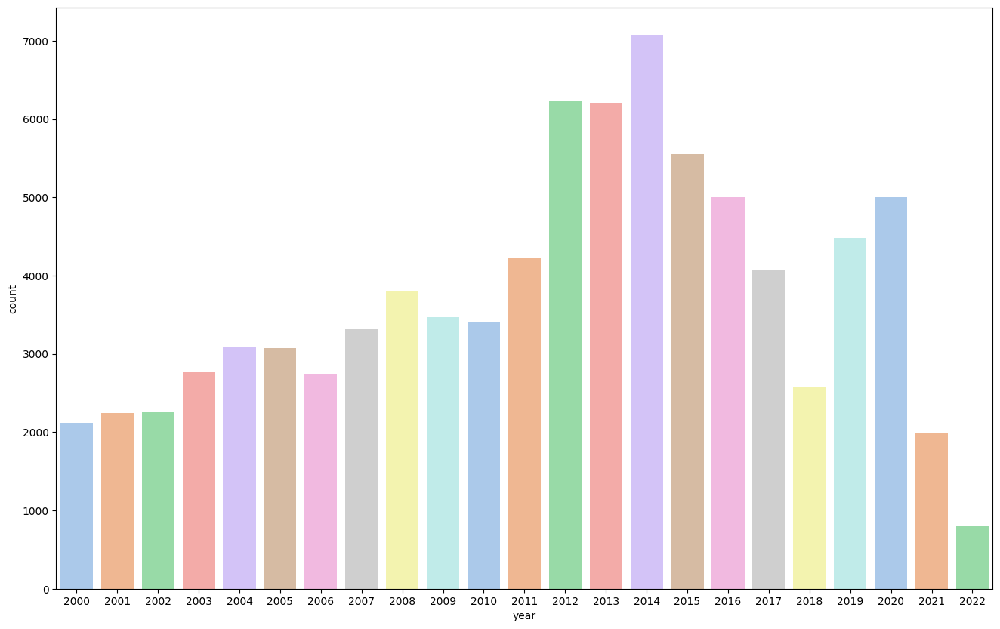

In [9]:
# 연도별 UFO Sighting Counting with using Countplot
plt.figure(figsize = (16, 10))
sns.countplot(data = usa, x = 'year', palette = 'pastel')

# 2014년에 가장 많이 보였고 2021년에 가장 적게 보였다
# 2022년(올해)은 아직 다 지나지 않았음으로 갯수가 가장 적을 수 밖에 없다!

In [10]:
# 월별 UFO Sighting Counting
usa['month'].value_counts()

7     9877
8     8569
10    8512
9     8162
11    7403
6     6979
12    6394
5     6193
1     6175
4     6143
3     5883
2     5216
Name: month, dtype: int64

<AxesSubplot:xlabel='month', ylabel='count'>

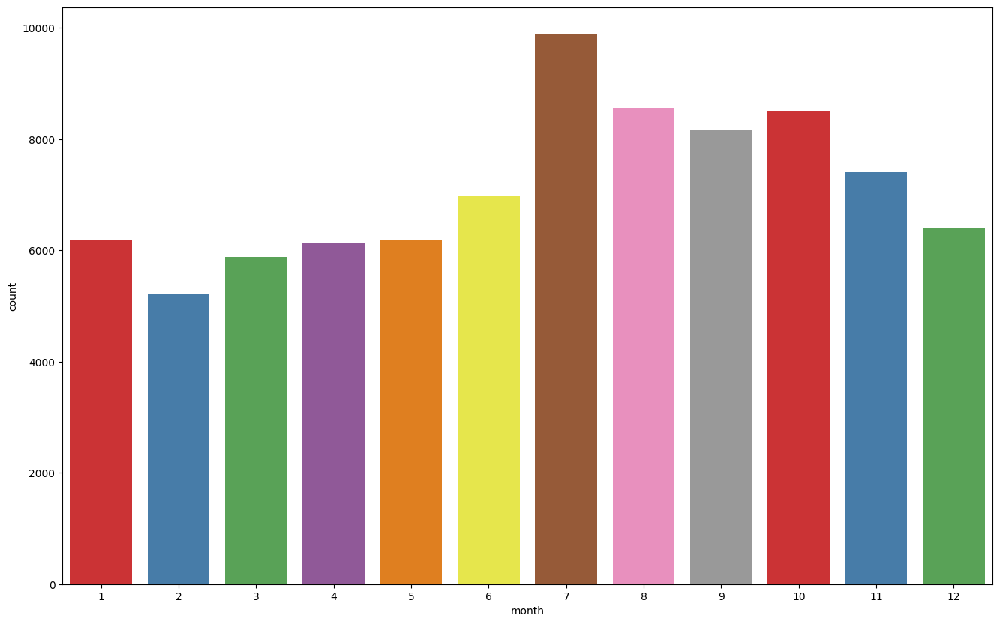

In [11]:
# 월별 UFO Sighting Counting with using Countplot
plt.figure(figsize = (16, 10))
sns.countplot(data = usa, x = 'month', palette = 'Set1')

# 7월에 가장 많이 발견되었고 2월에 가장 적게 발견되었다.
# Why?
# 여름에 밖에 자주 나가고 겨울에는 집에만 있기 때문!

In [ ]:
# 데이터 출처 : 기상청 자료개방포털
# https://data.kma.go.kr/data/ogd/selectGtsRltmList.do?pgmNo=658

# 미국 UFO 발견 건 수 TOP5개 주 기상 데이터
# 2000년부터 2022년 6월까지
# 일별 기상 데이터(기온, 강수량, 풍속, 습도, 기압)를 월별 평균으로 데이터 정제

# 상관계수는 -1 ~ 1까지의 범위를 가지며 
# 0.3 부터 상관관계가 있다고 판단한다.

<AxesSubplot:>

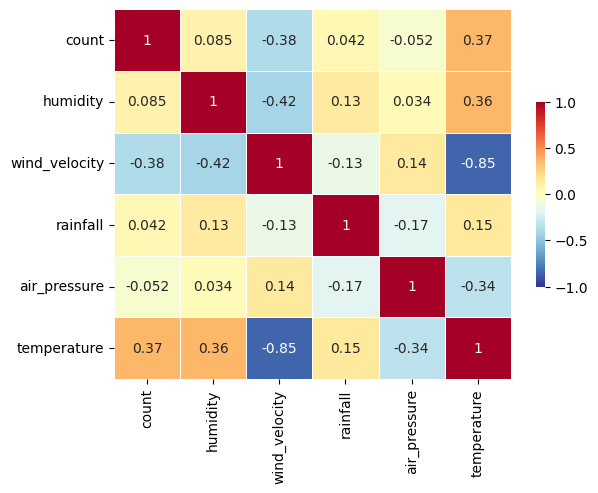

In [54]:
# 동부: 뉴욕 주
sns.heatmap(corr_NE, 
            cmap = 'RdYlBu_r', 
            annot = True,   # 실제 값을 표시한다  
            linewidths=.5,  # 경계면 실선으로 구분하기
            cbar_kws={"shrink": .5},# 컬러바 크기 절반으로 줄이기
            vmin = -1,vmax = 1   # 컬러바 범위 -1 ~ 1
           )

# 뉴욕의 월별 평균 기온(temperature)과 월별 UFO를 발견한 건수(count)의
# 상관계수가 0.37로 약한 양의 상관관계를 가지고 있다.
# 월별 풍속과 월별 UFO를 발견한 건수의 상관계수가 -0.38로 
# 약한 음의 상관관계를 가지고 있다.

<AxesSubplot:>

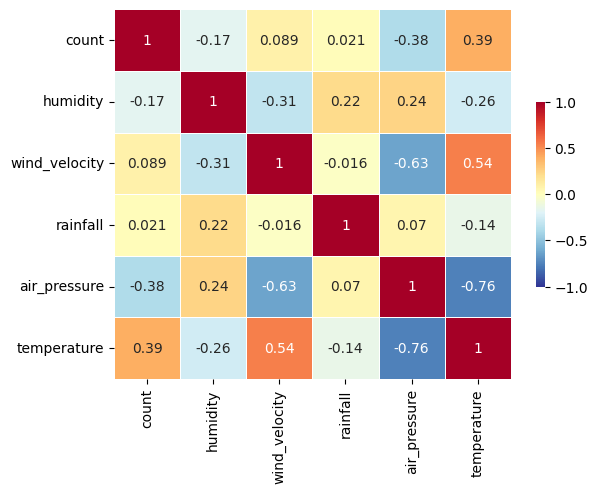

In [21]:
# 서부: 켈리포니아 주
sns.heatmap(corr_CA, 
            cmap = 'RdYlBu_r', 
            annot = True,   # 실제 값을 표시한다  
            linewidths=.5,  # 경계면 실선으로 구분하기
            cbar_kws={"shrink": .5},# 컬러바 크기 절반으로 줄이기
            vmin = -1,vmax = 1   # 컬러바 범위 -1 ~ 1
           )

# 캘리포니아의 월별 평균 기온(temperature)과 월별 UFO를 발견한 건수(count)의
# 상관계수가 0.39로 약한 양의 상관관계를 가지고 있다.

In [22]:
# 일별 UFO Sighting Counting
usa['day'].value_counts()

4     3834
15    3797
1     3781
20    2873
5     2839
7     2818
10    2805
12    2795
19    2774
24    2768
14    2745
3     2745
18    2722
25    2722
8     2718
22    2716
16    2687
11    2684
13    2682
17    2677
6     2651
23    2643
28    2633
21    2555
27    2524
2     2522
9     2495
26    2479
30    2467
29    2411
31    1944
Name: day, dtype: int64

<AxesSubplot:xlabel='day', ylabel='count'>

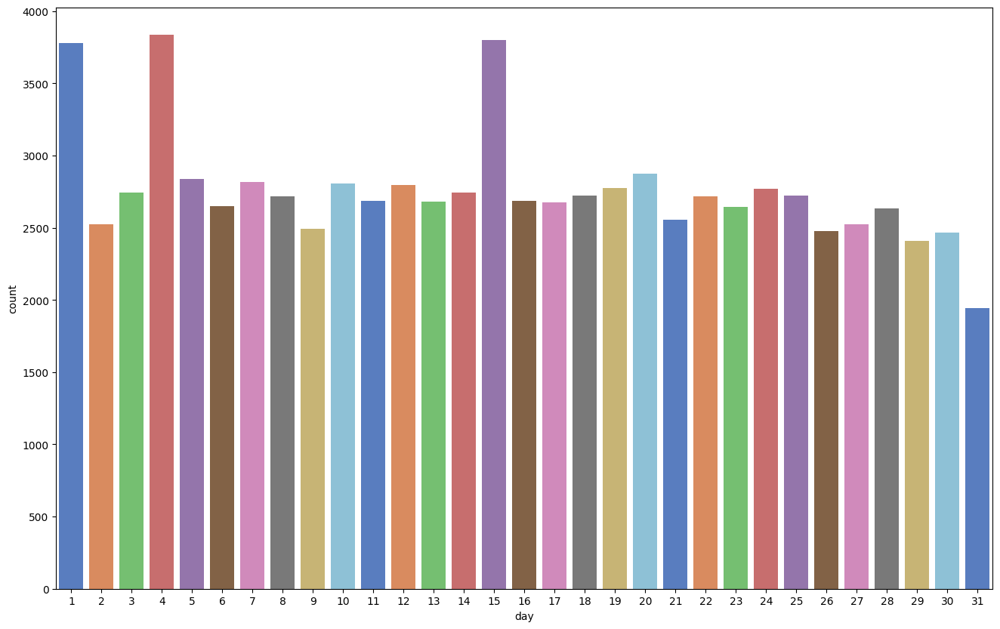

In [23]:
# 일별 UFO Sighting Counting with using Countplot
# 4일, 15일, 1일 순으로 많이 볼 수 있다. 
plt.figure(figsize = (16, 10))
sns.countplot(data = usa, x = 'day', palette = 'muted')

In [27]:
# 요일별 UFO Sighting Counting
usa['day_name'].value_counts()

# 토요일이 가장 많고 월요일이 가장 적다

Saturday     15945
Friday       12459
Sunday       12327
Thursday     11831
Wednesday    11536
Tuesday      10909
Monday       10499
Name: day_name, dtype: int64

<AxesSubplot:xlabel='day_name', ylabel='count'>

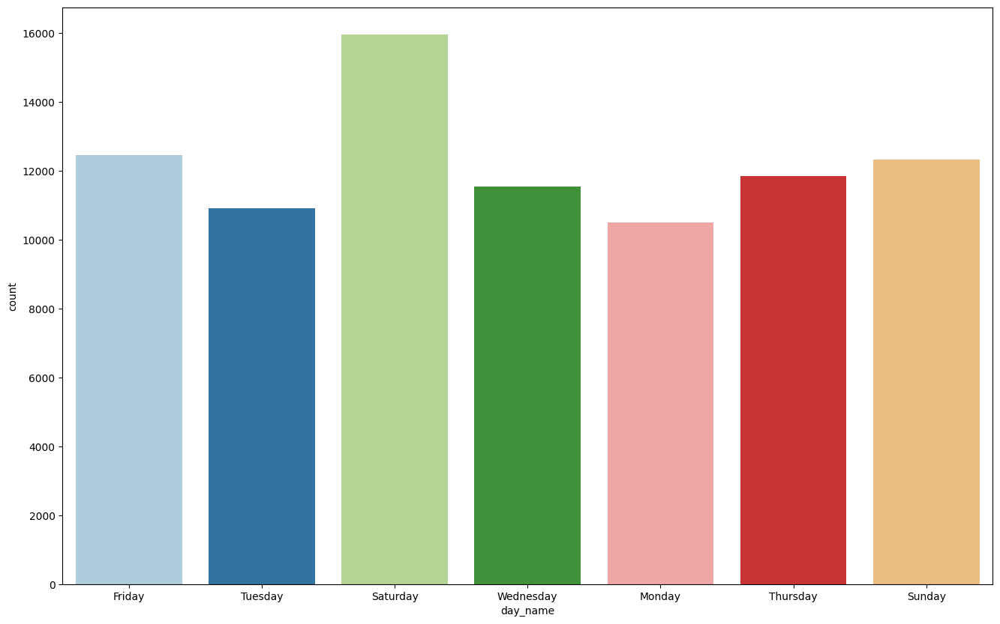

In [28]:
# 요일별 UFO Sighting Counting wiht using Countplot
plt.figure(figsize = (16, 10))
sns.countplot(data = usa, x = 'day_name', palette = 'Paired')

In [29]:
# 시간대별 UFO Sighting Counting
usa['hour'].value_counts()

21    12970
22    11538
20     9877
23     7817
19     6722
18     4524
0      4511
1      2992
17     2747
5      2096
2      2085
3      1995
4      1693
16     1671
6      1661
15     1360
12     1270
10     1263
14     1244
11     1231
13     1158
9      1097
7      1055
8       929
Name: hour, dtype: int64

In [30]:
usa[(usa['hour'] > 6) & (usa['hour'] < 21)]

# 총 85,506 건 중 36,148건을 뺀 49,358 건, 약 57%가 21시에서 5시까지 발견되었다. 

,date_time,city,statecode,country,shape,summary,year,month,hour,duration_sec,day,day_name
3,2000-03-11 12:30:00,Mobile,AL,USA,Triangle,a triangular shame with white lights marking t...,2000,3,12,60,11,Saturday
5,2000-04-19 19:10:00,Alabaster,AL,USA,Egg,One at a time appeared each in a different dir...,2000,4,19,60,19,Wednesday
6,2000-07-18 11:35:00,Huntsville,AL,USA,Circle,I watched the object from my front yard as it ...,2000,7,11,240,18,Tuesday
7,2000-10-31 20:00:00,Sipsey,AL,USA,Disk,"Round, flat UFO with lights all around, over H...",2000,10,20,60,31,Tuesday
8,2000-10-09 09:00:00,Kimberly,AL,USA,Unknown,EGG SHAPED WITH A T IN FRONT AND UNUSAL LIGHTS,2000,10,9,300,9,Monday
...,...,...,...,...,...,...,...,...,...,...,...,...
85490,2017-10-28 20:00:00,Cody and Wapiti (between),WY,USA,Fireball,There were fireballs coming down. ((anonymou...,2017,10,20,10,28,Saturday
85491,2017-12-14 19:50:00,Lusk,WY,USA,Fireball,I was driving in the town of Lusk and noticed ...,2017,12,19,30,14,Thursday
85492,2018-01-04 19:00:00,Riverton,WY,USA,Sphere,A strange orb appeared to be following my car.,2018,1,19,20,4,Thursday
85497,2019-10-22 19:27:00,Cheyenne,WY,USA,Light,I saw a white blueish light the size of bright...,2019,10,19,3,22,Tuesday


<AxesSubplot:xlabel='hour', ylabel='count'>

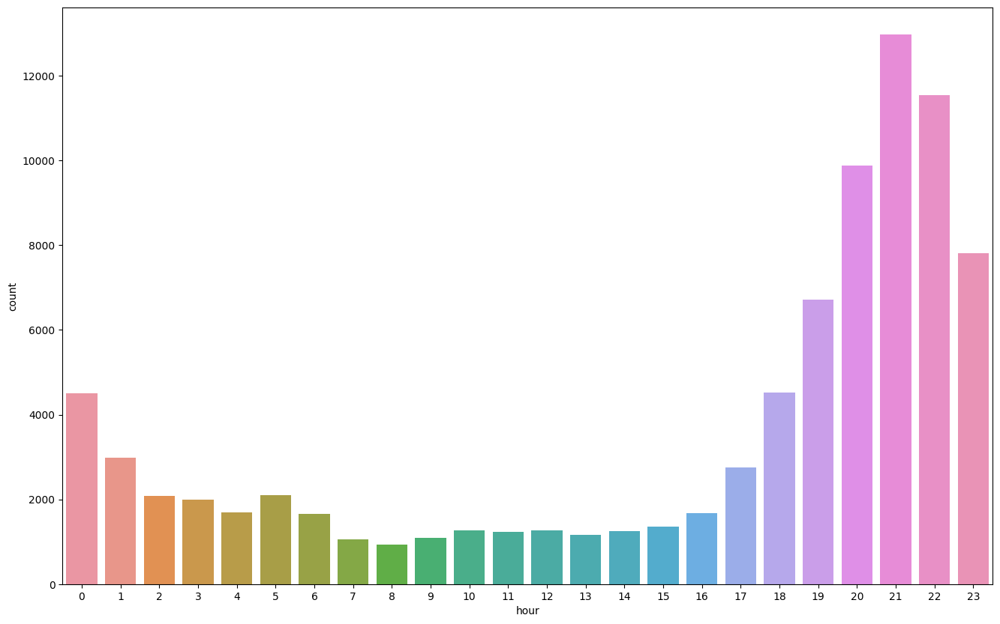

In [31]:
# 시간대별 UFO Sighting Counting with using Countplot
plt.figure(figsize = (16, 10))
sns.countplot(data = usa, x = 'hour')

# 주로 21시 이후부터 23시까지 많이 분포되어있음을 볼 수 있다.

In [32]:
# State 별 Top 5 Counting
usa['statecode'].value_counts().head()

# 캘리포니아, 플로리다, 워싱턴, 텍사스, 뉴욕 주 순으로 많이 보인 것을 알 수 있다.

CA    10745
FL     5581
WA     4499
TX     3716
NY     3672
Name: statecode, dtype: int64

<AxesSubplot:xlabel='statecode', ylabel='count'>

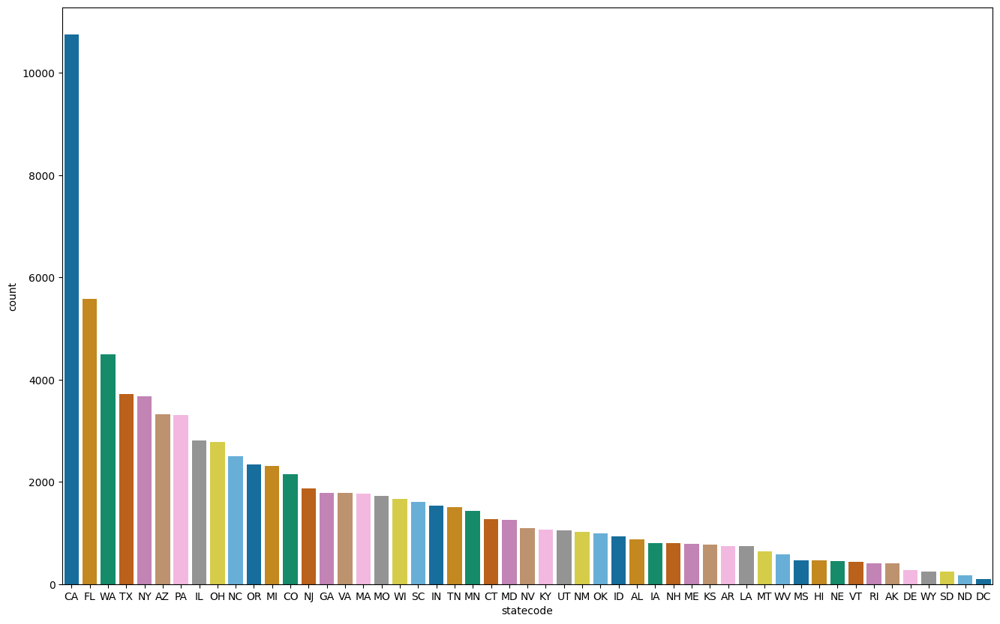

In [33]:
# State 별 Counting with using Countplot
plt.figure(figsize = (16, 10))
sns.countplot(data = usa, x = 'statecode', palette = 'colorblind', order = usa['statecode'].value_counts().index)

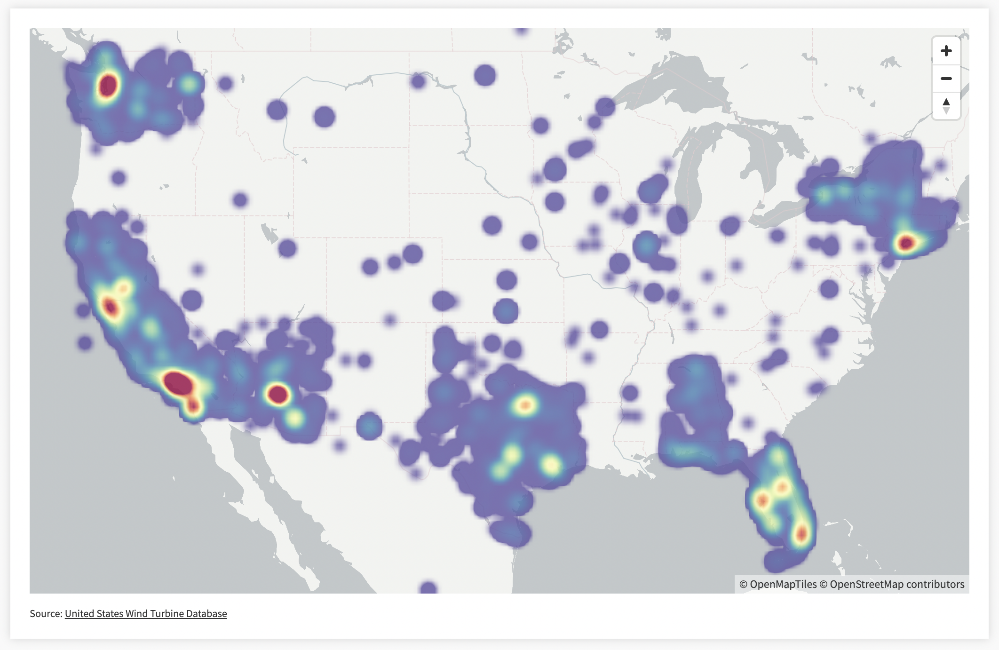

In [53]:
# 미국 전역에서 UFO Sighting with using heatmap
Image('/Users/sung/Desktop/heatmap.png')

In [34]:
# Shape별 Top 5 Counting
usa['shape'].value_counts().head()

# 빛 모양, 원 모양, 삼각형 모양, 불꽃모양, 창 모양 순으로 많이 발견되었음을 볼 수 있다.

Light       19163
Circle       9658
Triangle     8089
Fireball     6846
Sphere       6046
Name: shape, dtype: int64

<AxesSubplot:xlabel='shape', ylabel='count'>

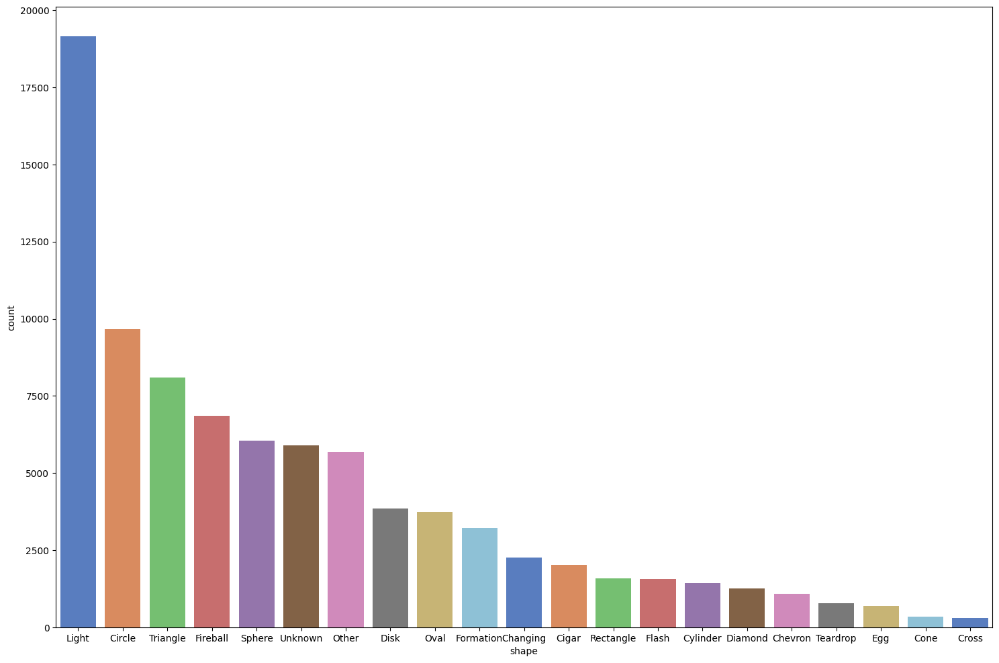

In [35]:
# shape별 UFO sighting Counting wiht using Countplot
plt.figure(figsize = (18, 12))
sns.countplot(data = usa, x = 'shape', palette = 'muted', order = usa['shape'].value_counts().index)

# Analysis with Duration

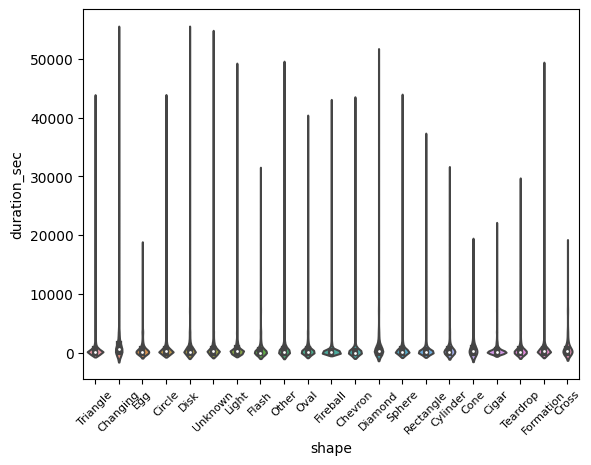

In [36]:
# 전체 데이터를 가지고 만들어보니 값들이 너무 다양하여 
# 밑과 같이 boxplot이나 violinplot으로 분포를 그리기 힘듬
# 고로, duration_sec의 범위를 조정해줄 필요가 있다고 판단하였다.
sns.violinplot(data = usa, x = 'shape', y = 'duration_sec')
plt.xticks(rotation = 45, fontsize = 8)
plt.show()

In [37]:
# 그리하여 임의로 120초 미만으로 제한해봤다
under_2min = usa[usa['duration_sec'] < 120]

<AxesSubplot:xlabel='shape', ylabel='duration_sec'>

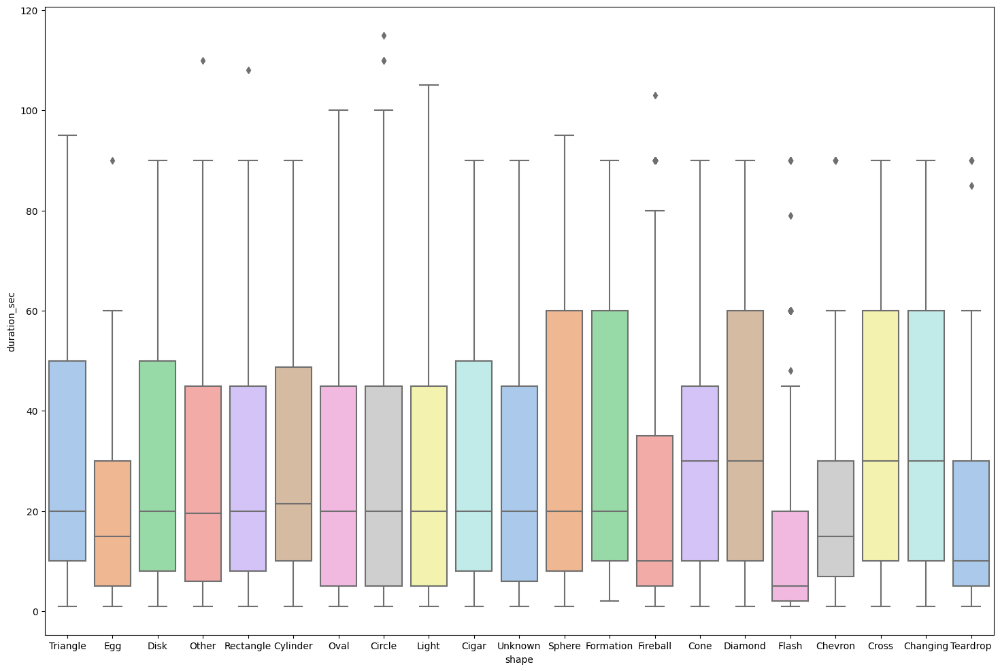

In [38]:
# 성공적으로 재정의 후 다시 boxplot을 그려보았는데
# 여전히 분포를 크게 보기 힘들었다.
# 하지만 이로써 60초 미만의 값들이 많은 것을 알 수 있었다.
plt.figure(figsize = (18, 12))
sns.boxplot(data = under_2min, x = 'shape', y = 'duration_sec', palette = 'pastel')

<AxesSubplot:xlabel='shape', ylabel='duration_sec'>

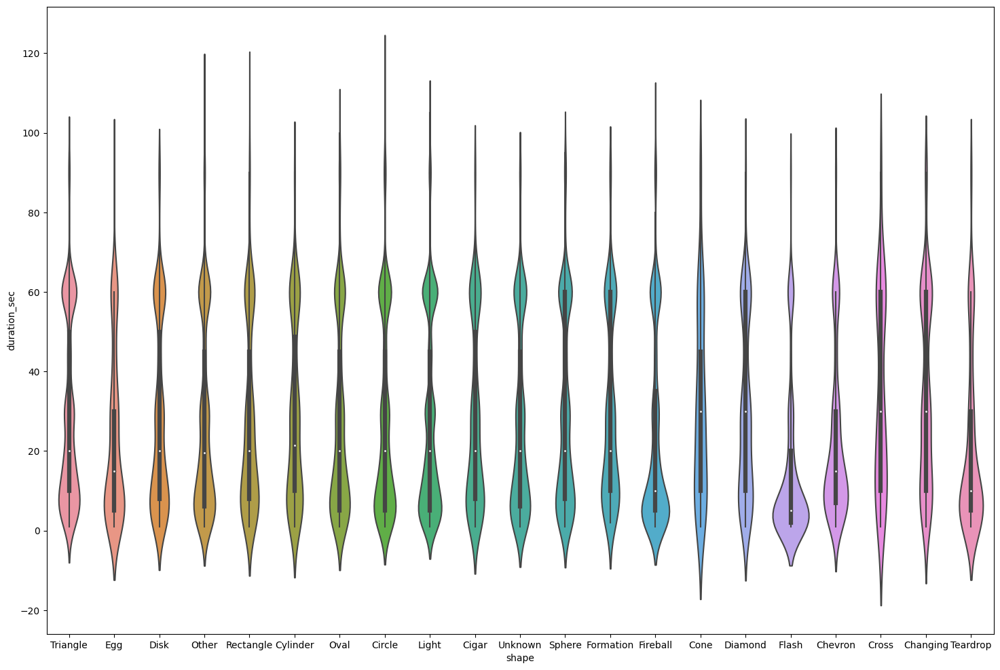

In [39]:
# 좀 더 분포도를 보기 쉬운 violinplot으로도 그려보았다.
plt.figure(figsize = (18, 12))
sns.violinplot(data = under_2min, x = 'shape', y = 'duration_sec')

# 30초 미만의 수가 압도적으로 많지만
# 60초도 은근히 많은 것을 볼 수 있다.
# Why?
# 대략적인 시간을 1분으로 많이 나타낸 것으로 보임

<AxesSubplot:xlabel='shape', ylabel='duration_sec'>

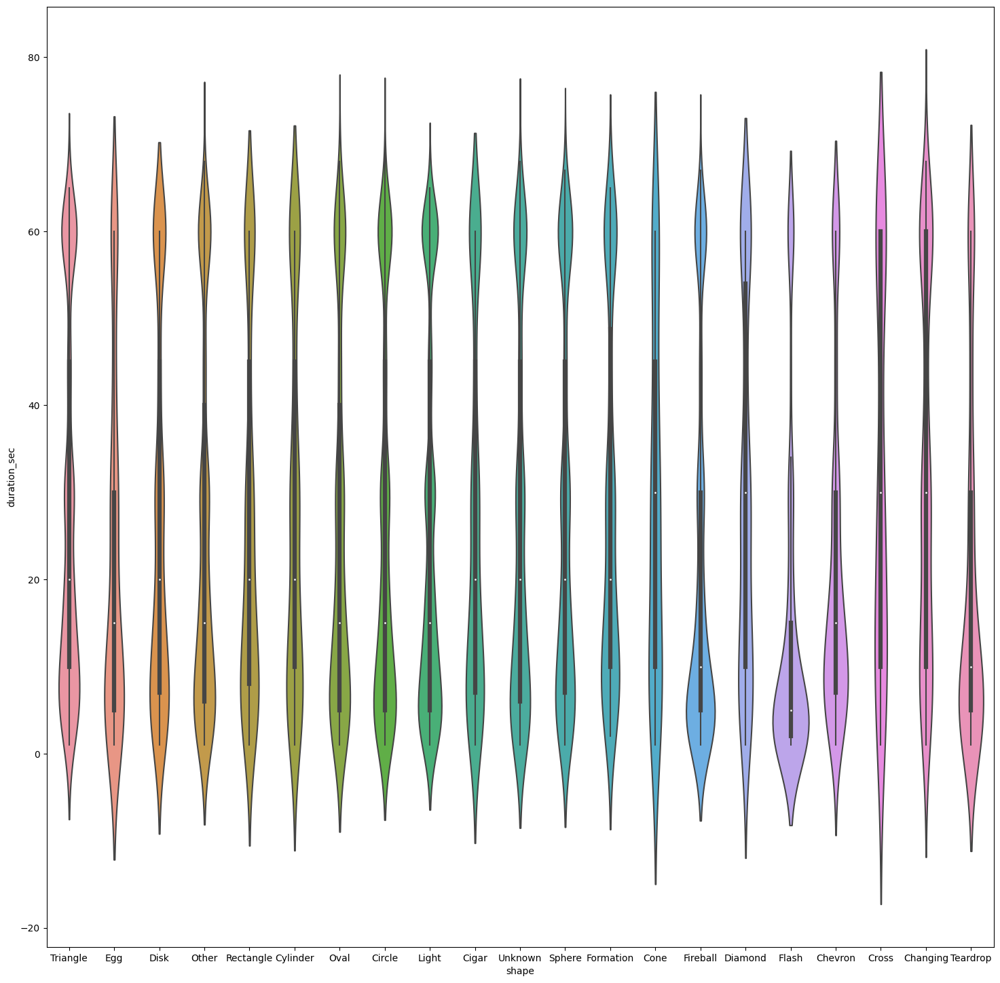

In [40]:
# 이를 토대로 duration_sec를 70초 미만으로 제한하고 
# 다시 Violinplot을 그려보았다.
under_70sec = usa[usa['duration_sec'] < 70]
plt.figure(figsize = (18, 18))
sns.violinplot(data = under_70sec, x = 'shape', y = 'duration_sec')

# 좀 더 보기 쉽게 violinplot이 그려진 것을 볼 수 있다.

<AxesSubplot:xlabel='count', ylabel='duration_sec'>

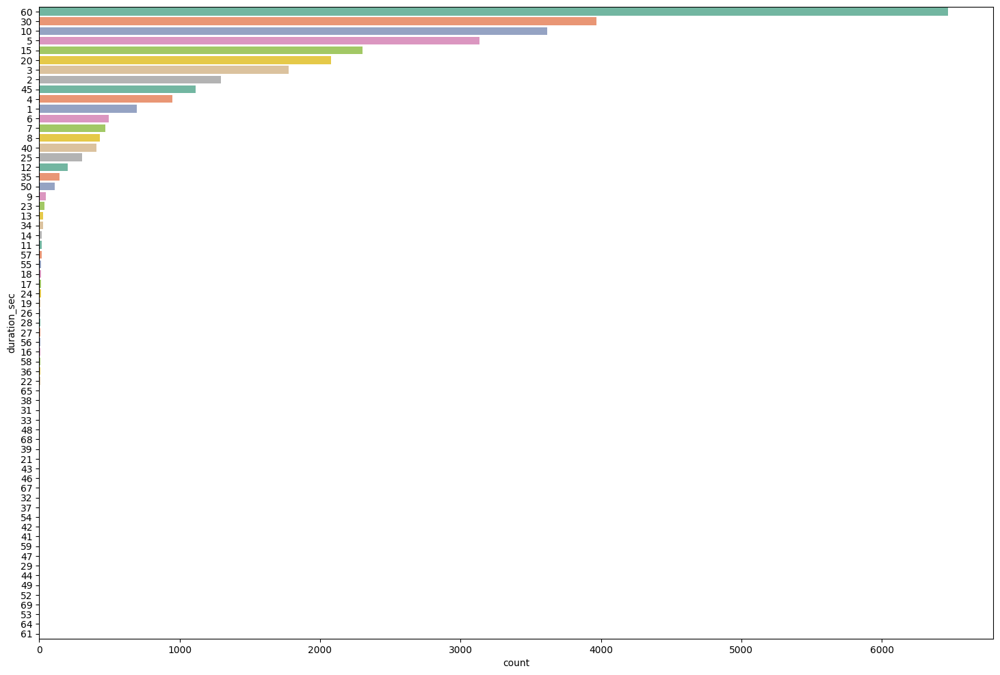

In [41]:
# 그렇다면 이제 70초 미만에서 각 초마다 사람들이 본 횟수는 얼마나 될까?
plt.figure(figsize = (18, 12))
sns.countplot(data = under_70sec, y = 'duration_sec', palette = 'Set2', 
              order = under_70sec['duration_sec'].value_counts().index)

# 이것으로도 사람들이 10 15 20 30 60초 등 정형화된 시간 개념에 따라 대답한 경우가 많은 것을 볼 수 있다.
# 당연하겠지만? ufo를 보았을 때 구체적으로 시간을 잰 사람이 거의 없다는 것!

<AxesSubplot:xlabel='duration_sec'>

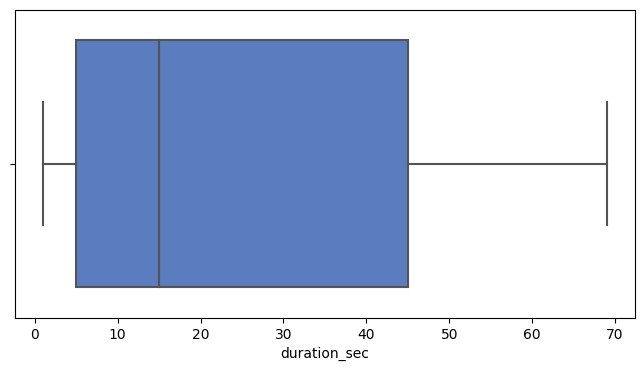

In [42]:
# 각 초마다 비중이 어떻게 되는지 보기 위한 boxplot
plt.figure(figsize = (8, 4))
sns.boxplot(data = under_70sec, x = 'duration_sec', palette = 'muted')

<AxesSubplot:xlabel='duration_sec'>

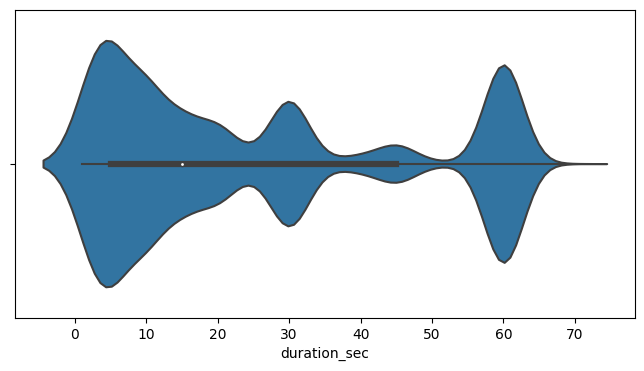

In [43]:
# 각 초마다 비중이 어떻게 되는지 보기 위한 violinplot
plt.figure(figsize = (8, 4))
sns.violinplot(data = under_70sec, x = 'duration_sec')

# 약 5초정도가 가장 많고 60초 정도에도 많은 것을 볼 수 있다.

In [46]:
# UFO가 가장 많이 발견된 상위 5개 주를 DataFrame화 
top5_s = under_70sec[(under_70sec['statecode'] == 'CA') | 
                     (under_70sec['statecode'] == 'FL') | 
                     (under_70sec['statecode'] == 'TX') | 
                     (under_70sec['statecode'] == 'WA') | 
                     (under_70sec['statecode'] == 'NY')]
top5_s.head(1)

,date_time,city,statecode,country,shape,summary,year,month,hour,duration_sec,day,day_name
3608,2000-01-24 13:00:00,Mammoth Lakes,CA,USA,Disk,"Two white craft, flying in close formation.",2000,1,13,60,24,Monday


<AxesSubplot:xlabel='statecode', ylabel='duration_sec'>

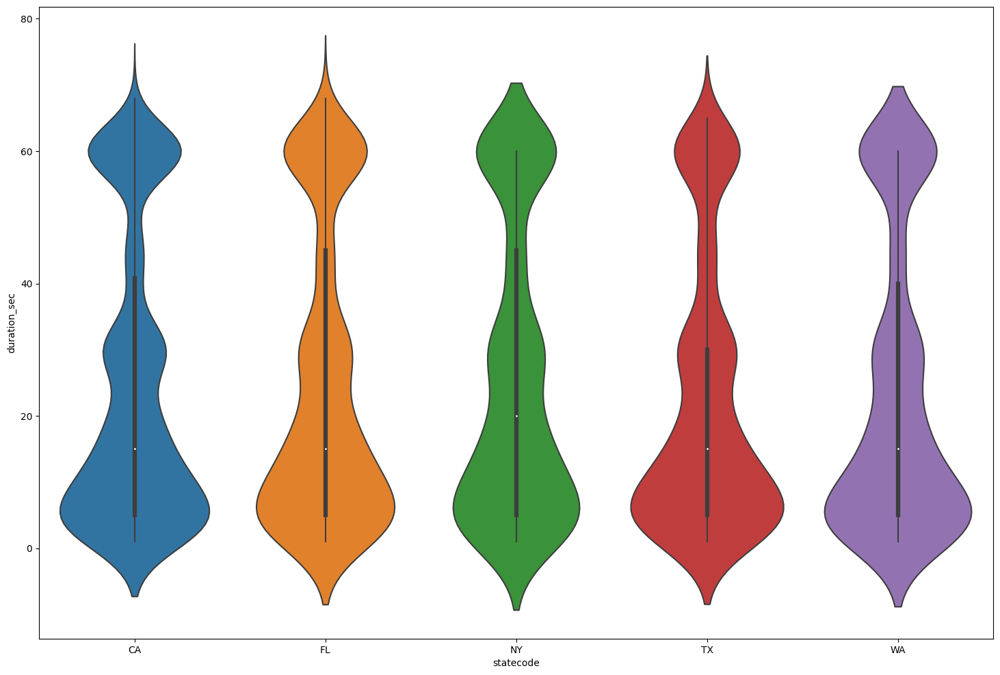

In [47]:
# 가장 많이 발견된 주 5개 중에서 70초 미만 duration_sec 분포를 보기 위한 violinplot
plt.figure(figsize = (18, 12))
sns.violinplot(data = top5_s, x = 'statecode', y = 'duration_sec')

(-0.5, 449.5, 449.5, -0.5)

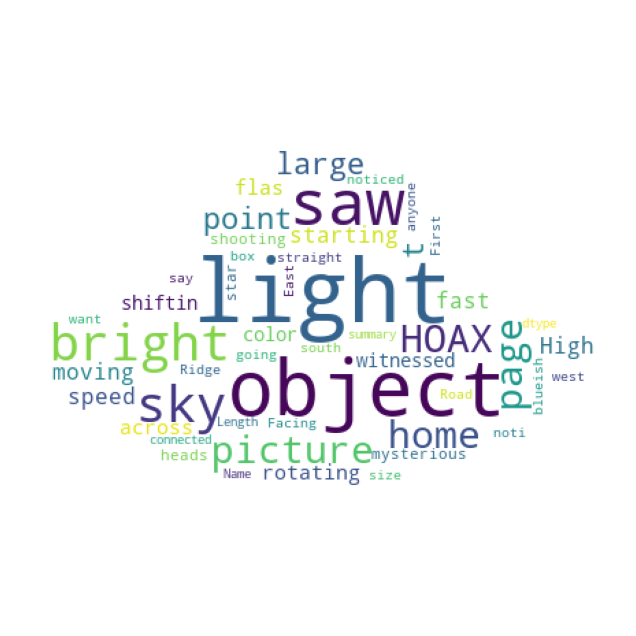

In [49]:
# 빛 모양에 대한 summary를 wordclouding
lig_sum = usa[usa['shape'] == 'Light']['summary']
summ = lig_sum
mask = Image.open('/Users/sung/Downloads/ufo3.jpeg')
mask = np.array(mask)


wc = WordCloud(
        background_color = 'white',
        stopwords = stopwords,
        mask = mask)
wc.generate(str(summ))
plt.figure(figsize = (8, 8))
plt.imshow(wc)
plt.axis('off')

(-0.5, 449.5, 449.5, -0.5)

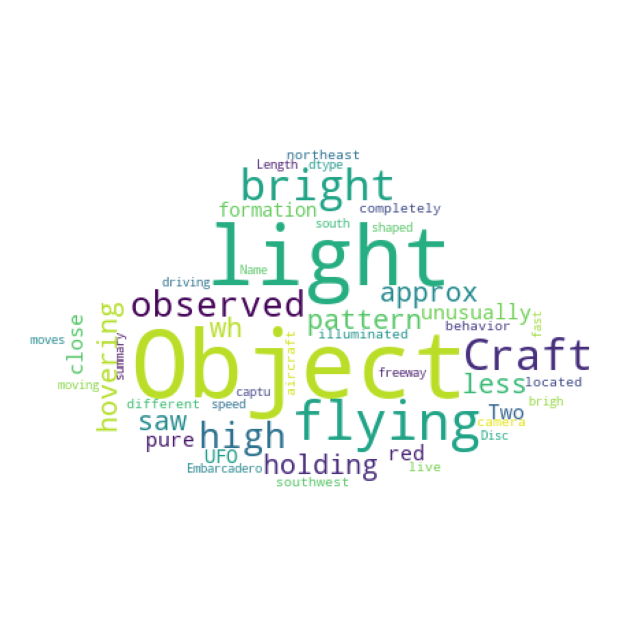

In [50]:
# California 주에 대한 summary를 wordclouding
ca_sum = usa[usa['statecode'] == 'CA']['summary']
summ = ca_sum
mask = Image.open('/Users/sung/Downloads/ufo3.jpeg')
mask = np.array(mask)


wc = WordCloud(
        background_color = 'white',
        stopwords = stopwords,
        mask = mask)
wc.generate(str(summ))
plt.figure(figsize = (8, 8))
plt.imshow(wc)
plt.axis('off')

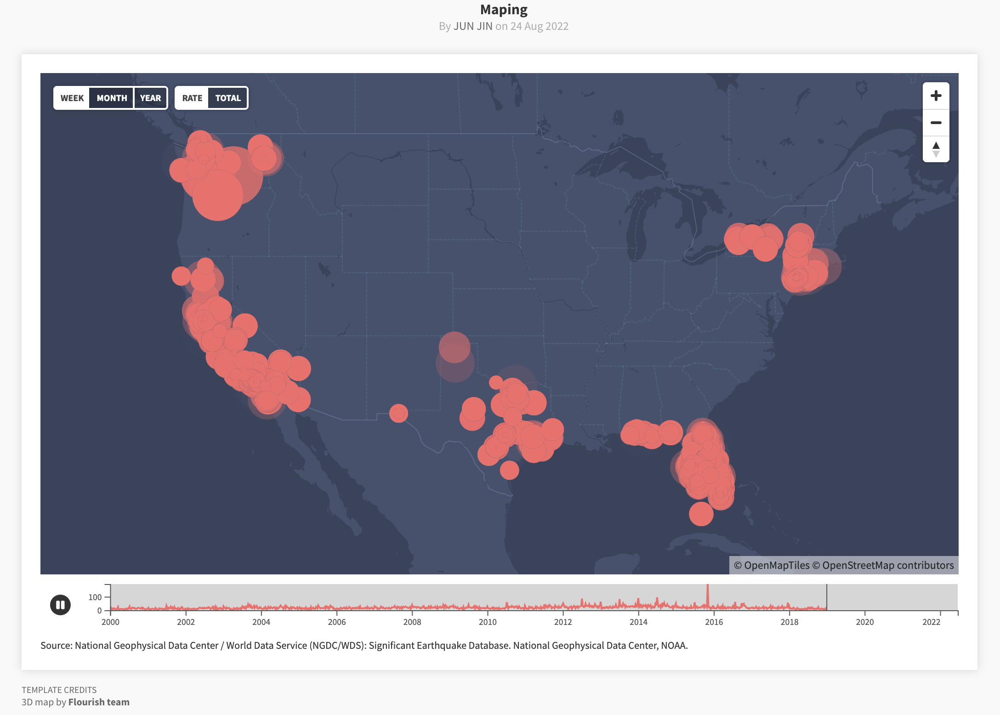

In [10]:
Image("/Users/bella/Desktop/Flourish Maping.png")

## Cramer’s V계수 상관분석

/var/folders/p8/l11h48815c95y2w3m08v08b80000gn/T/ipykernel_8478/1806058523.py:6: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.zeros_like(df, dtype=np.bool)


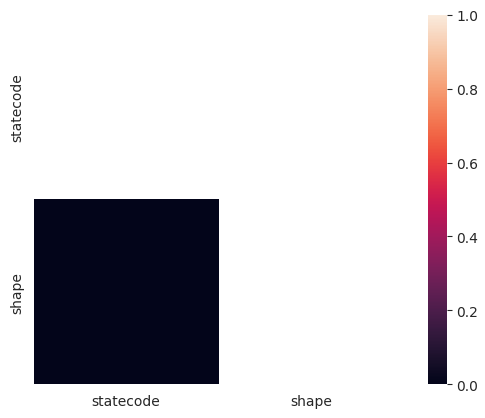

In [78]:
import seaborn as sns
import matplotlib.pyplot as plt

mask = np.zeros_like(df, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

with sns.axes_style("white"):
  ax = sns.heatmap(df, mask=mask,vmin=0., vmax=1, square=True)

plt.show()

<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">6. 결론</font><br>
- 연도: 2000년~2022년 중 2014년에 가장 많이, 2022&2021년에 가장 적게 목격되었다.<br>
- 월: 1월~12월 중 7월에 가장 많이, 2월에 가장 적게 목격되었다.<br>
- 일: 4일, 15일 1일 순으로 목격되었다.<br>
- 요일: 일주일 중 토요일에 가장 많이, 월요일에 가장 적게 목격되었다.<br>
- 시간: 24시간 중 21시에 가장 많이, 8시에 가장 적게 목격되었다.<br>
- 지역: 미국 52개 주 중 캘리포니아에서 가장 많이, 워싱턴 DC에서 가장 적게 목격되었다.<br>
- 모양: UFO 모양은 빛(ligth) 모양이 가장 많이, 십자형태(cross)&콘(cone) 모양이 가장 적게 목격되었다.<br>
- 목격 듀레이션: 전체 1초~54,600초(약 15시간) 중 5초 듀레이션 구간이 가장 많았고, 53초 구간이 가장 적게 나타났다.<br>
- 지역+모양: 미국 주와 UFO 모양은 상관관계가 없는 걸로 분석되었다.<br>
</div>

<div class="alert alert-block" style="border: 1px solid #FFB300;background-color:#F9FBE7;">
<font size="5em" style="font-weight:bold;color:#3f8dbf;">7. 추가</font><br>
본 분석데이터를 기반으로 UFO 출몰지역 및 관광지로 구성된 '미국서부 UFO 투어 코스'를 구글어스로 제작해보았다.<br>
</div>

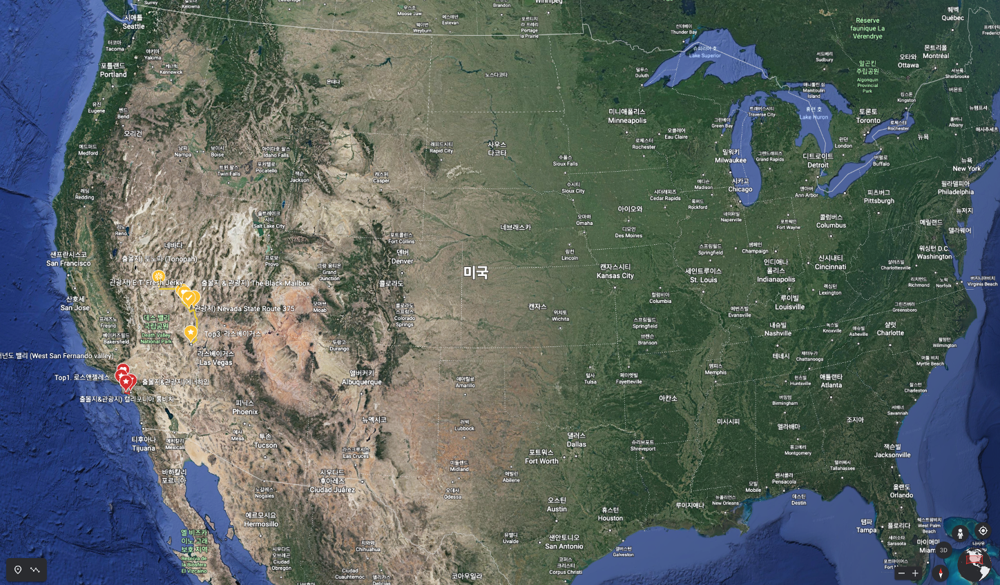

In [7]:
Image("/Users/bella/Desktop/google earth_1.png")

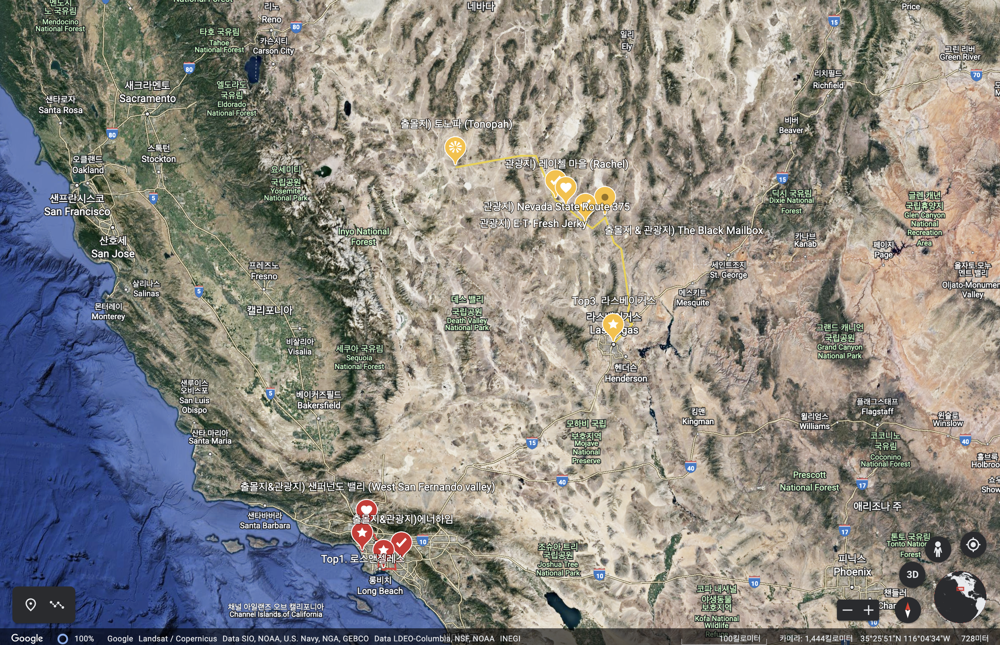

In [8]:
Image("/Users/bella/Desktop/google earth_2.png")